# Diabetes Prediction Challenge

The dataset for this competition (both train and test) was generated from a deep learning model trained on the Diabetes Health Indicators Dataset. Feature distributions are close to, but not exactly the same, as the original. Feel free to use the original dataset as part of this competition, both to explore differences as well as to see whether incorporating the original in training improves model performance. diagnosed_diabetes is the target, and for the testing data, you should predict the probability of diagnosed_diabetes

# IMPORT LIBS

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import math

# from IPython.core.interactiveshell import InteractiveShell
# InteractiveShell.ast_node_interactivity = "all"
# # Set options to display all rows, columns, and prevent wrapping
# pd.set_option('display.max_rows', None)
# pd.set_option('display.max_columns', None)
# pd.set_option('display.width', None) # CRITICAL for preventing wrapping

# IMPORT DATA SET

In [2]:
github_df_train_url = "https://raw.githubusercontent.com/Eddythemachine/diabetes_pred_kaggle_hackathon/main/data/raw/train.csv"
github_df_test_url = "https://raw.githubusercontent.com/Eddythemachine/diabetes_pred_kaggle_hackathon/main/data/raw/test.csv"

try:
    df_train = pd.read_csv(github_df_train_url)
    df_test = pd.read_csv(github_df_test_url)
    print("Data imported successfully!")
    print(f"df_train shape: {df_train.shape}")
    print(f"df_test shape: {df_test.shape}")
except Exception as e:
    print(f"Error importing data. Please ensure the URLs are correct and the files are publicly accessible.")
    print(f"Error details: {e}")

Data imported successfully!
df_train shape: (700000, 26)
df_test shape: (300000, 25)


In [3]:
print(df_train.head())
print(df_test.head())

   id  age  alcohol_consumption_per_week  physical_activity_minutes_per_week  \
0   0   31                             1                                  45   
1   1   50                             2                                  73   
2   2   32                             3                                 158   
3   3   54                             3                                  77   
4   4   54                             1                                  55   

   diet_score  sleep_hours_per_day  screen_time_hours_per_day   bmi  \
0         7.7                  6.8                        6.1  33.4   
1         5.7                  6.5                        5.8  23.8   
2         8.5                  7.4                        9.1  24.1   
3         4.6                  7.0                        9.2  26.6   
4         5.7                  6.2                        5.1  28.8   

   waist_to_hip_ratio  systolic_bp  ...  gender  ethnicity  education_level  \
0            

# EDA

In [4]:
# Check nan values
print(df_train.isna().sum())
print(df_test.isna().sum())

id                                    0
age                                   0
alcohol_consumption_per_week          0
physical_activity_minutes_per_week    0
diet_score                            0
sleep_hours_per_day                   0
screen_time_hours_per_day             0
bmi                                   0
waist_to_hip_ratio                    0
systolic_bp                           0
diastolic_bp                          0
heart_rate                            0
cholesterol_total                     0
hdl_cholesterol                       0
ldl_cholesterol                       0
triglycerides                         0
gender                                0
ethnicity                             0
education_level                       0
income_level                          0
smoking_status                        0
employment_status                     0
family_history_diabetes               0
hypertension_history                  0
cardiovascular_history                0


In [5]:
# Check Duplicates
print(df_train.duplicated().sum())
print(df_test.duplicated().sum())

0
0


In [6]:
# Dataset info
print(df_train.info())
print(df_test.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700000 entries, 0 to 699999
Data columns (total 26 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   id                                  700000 non-null  int64  
 1   age                                 700000 non-null  int64  
 2   alcohol_consumption_per_week        700000 non-null  int64  
 3   physical_activity_minutes_per_week  700000 non-null  int64  
 4   diet_score                          700000 non-null  float64
 5   sleep_hours_per_day                 700000 non-null  float64
 6   screen_time_hours_per_day           700000 non-null  float64
 7   bmi                                 700000 non-null  float64
 8   waist_to_hip_ratio                  700000 non-null  float64
 9   systolic_bp                         700000 non-null  int64  
 10  diastolic_bp                        700000 non-null  int64  
 11  heart_rate                

In [7]:
# Dataset Description
df_train.describe()

,id,age,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,sleep_hours_per_day,screen_time_hours_per_day,bmi,waist_to_hip_ratio,systolic_bp,diastolic_bp,heart_rate,cholesterol_total,hdl_cholesterol,ldl_cholesterol,triglycerides,family_history_diabetes,hypertension_history,cardiovascular_history,diagnosed_diabetes
count,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000
mean,349999.500000,50.359734,2.072411,80.230803,5.963695,7.002200,6.012733,25.874684,0.858766,116.294193,75.440924,70.167749,186.818801,53.823214,102.905854,123.081850,0.149401,0.181990,0.030324,0.623296
std,202072.738554,11.655520,1.048189,51.195071,1.463336,0.901907,2.022707,2.860705,0.037980,11.010390,6.825775,6.938722,16.730832,8.266545,19.022416,24.739397,0.356484,0.385837,0.171478,0.484560
min,0.000000,19.000000,1.000000,1.000000,0.100000,3.100000,0.600000,15.100000,0.680000,91.000000,51.000000,42.000000,117.000000,21.000000,51.000000,31.000000,0.000000,0.000000,0.000000,0.000000
25%,174999.750000,42.000000,1.000000,49.000000,5.000000,6.400000,4.600000,23.900000,0.830000,108.000000,71.000000,65.000000,175.000000,48.000000,89.000000,106.000000,0.000000,0.000000,0.000000,0.000000
50%,349999.500000,50.000000,2.000000,71.000000,6.000000,7.000000,6.000000,25.900000,0.860000,116.000000,75.000000,70.000000,187.000000,54.000000,103.000000,123.000000,0.000000,0.000000,0.000000,1.000000
75%,524999.250000,58.000000,3.000000,96.000000,7.000000,7.600000,7.400000,27.800000,0.880000,124.000000,80.000000,75.000000,199.000000,59.000000,116.000000,139.000000,0.000000,0.000000,0.000000,1.000000
max,699999.000000,89.000000,9.000000,747.000000,9.900000,9.900000,16.500000,38.400000,1.050000,163.000000,104.000000,101.000000,289.000000,90.000000,205.000000,290.000000,1.000000,1.000000,1.000000,1.000000


Instance of a potential data Anomaly detechted in physical_activity_minutes_per_week, ldl_cholesterol, triglycerides

In [8]:
# Test Description
df_test.describe()

,id,age,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,sleep_hours_per_day,screen_time_hours_per_day,bmi,waist_to_hip_ratio,systolic_bp,diastolic_bp,heart_rate,cholesterol_total,hdl_cholesterol,ldl_cholesterol,triglycerides,family_history_diabetes,hypertension_history,cardiovascular_history
count,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000
mean,849999.500000,50.432397,2.089693,92.349087,5.945838,6.997795,6.011278,25.881906,0.859007,116.374117,75.396013,70.048350,187.308620,53.813557,103.416083,123.538480,0.152920,0.184410,0.033110
std,86602.684716,11.938741,1.066214,62.187399,1.481068,0.914693,2.060472,2.894289,0.038523,11.252146,6.950340,7.090543,18.413053,8.398126,20.571855,28.965441,0.359911,0.387819,0.178924
min,700000.000000,19.000000,1.000000,1.000000,0.100000,3.100000,0.600000,15.100000,0.690000,91.000000,51.000000,42.000000,107.000000,22.000000,51.000000,31.000000,0.000000,0.000000,0.000000
25%,774999.750000,42.000000,1.000000,51.000000,5.000000,6.400000,4.600000,23.900000,0.830000,108.000000,71.000000,65.000000,174.000000,48.000000,89.000000,104.000000,0.000000,0.000000,0.000000
50%,849999.500000,50.000000,2.000000,77.000000,6.000000,7.000000,6.000000,25.900000,0.860000,116.000000,75.000000,70.000000,187.000000,54.000000,103.000000,123.000000,0.000000,0.000000,0.000000
75%,924999.250000,59.000000,3.000000,115.000000,7.000000,7.600000,7.400000,27.800000,0.890000,124.000000,80.000000,75.000000,200.000000,60.000000,117.000000,142.000000,0.000000,0.000000,0.000000
max,999999.000000,89.000000,9.000000,748.000000,9.900000,9.900000,15.900000,38.300000,1.050000,170.000000,104.000000,101.000000,285.000000,91.000000,226.000000,290.000000,1.000000,1.000000,1.000000


In [9]:
# Seperate num and cat cols
num_cols = df_train.select_dtypes(include=["int64", "float64"]).columns
cat_cols = df_train.select_dtypes(include=["object", "category"]).columns

target_col = "diagnosed_diabetes"

if target_col in num_cols:
    num_cols = num_cols.drop(target_col)

id = "id"

if id in num_cols:
    num_cols = num_cols.drop(id)

col_df = [num_cols, cat_cols]
print(col_df)

[Index(['age', 'alcohol_consumption_per_week',
       'physical_activity_minutes_per_week', 'diet_score',
       'sleep_hours_per_day', 'screen_time_hours_per_day', 'bmi',
       'waist_to_hip_ratio', 'systolic_bp', 'diastolic_bp', 'heart_rate',
       'cholesterol_total', 'hdl_cholesterol', 'ldl_cholesterol',
       'triglycerides', 'family_history_diabetes', 'hypertension_history',
       'cardiovascular_history'],
      dtype='object'), Index(['gender', 'ethnicity', 'education_level', 'income_level',
       'smoking_status', 'employment_status'],
      dtype='object')]


In [10]:
print(num_cols)
print(cat_cols)

Index(['age', 'alcohol_consumption_per_week',
       'physical_activity_minutes_per_week', 'diet_score',
       'sleep_hours_per_day', 'screen_time_hours_per_day', 'bmi',
       'waist_to_hip_ratio', 'systolic_bp', 'diastolic_bp', 'heart_rate',
       'cholesterol_total', 'hdl_cholesterol', 'ldl_cholesterol',
       'triglycerides', 'family_history_diabetes', 'hypertension_history',
       'cardiovascular_history'],
      dtype='object')
Index(['gender', 'ethnicity', 'education_level', 'income_level',
       'smoking_status', 'employment_status'],
      dtype='object')


# DATA VISUALISATION

## NUMERICAL VARIABLES

### Histogram

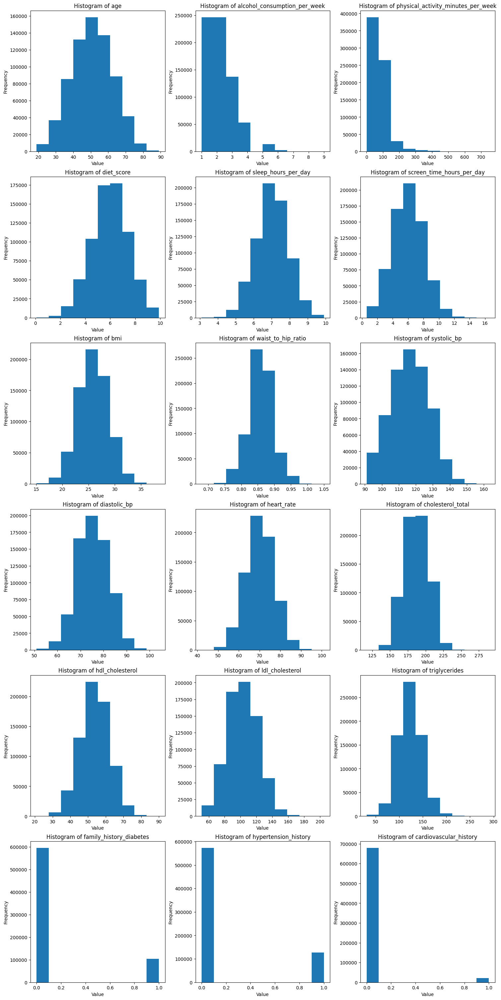

In [11]:
# Histogram
# --- Configuration for the grid ---
N_cols = 3  # How many plots per row
N_rows = math.ceil(len(num_cols) / N_cols) # Calculate needed rows dynamically
figsize_width = 15
figsize_height = N_rows * 5 # Adjust height based on number of rows

# 1. Create the figure and a grid of axes ONLY ONCE
fig, axes = plt.subplots(nrows=N_rows, ncols=N_cols, figsize=(figsize_width, figsize_height), constrained_layout=True)

# 2. Flatten the axes array for easy indexing (makes axes[0, 0] become axes[0], etc.)
if N_rows > 1:
    axes = axes.flatten()

# 3. Loop through your columns and plot them onto the specific axes
for i, col_name in enumerate(num_cols):
    # Select the correct axis for this iteration
    ax = axes[i]

    # Plot the histogram using the axis object's methods (ax.hist instead of plt.hist)
    ax.hist(df_train[col_name].dropna()) # Dropna is good practice if data is messy

    # Set titles and labels using the axis object's methods (ax.set_title instead of plt.title)
    ax.set_title(f'Histogram of {col_name}')
    ax.set_xlabel("Value")
    ax.set_ylabel("Frequency")

# 4. Remove any unused subplots if the total number isn't a perfect grid fit
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# 5. Display all plots together in one single window
plt.show()

### Insight

1. General Observation
Data Quality: The data appears remarkably clean. Most continuous variables (like blood pressure, cholesterol, and age) follow a near-perfect Normal Distribution (Bell Curve). This suggests the dataset is either from a very large, well-sampled population or is synthetically generated for educational/testing purposes.

Sample Size: The frequency counts (y-axis) are very high (reaching up to 600,000+), indicating a massive dataset.

2. Lifestyle Insights
Sedentary Behavior:

Physical Activity: This distribution is heavily right-skewed. The vast majority of individuals get very little physical activity (0–100 minutes/week), with a sharp drop-off as activity increases.

Screen Time: Conversely, screen time follows a normal distribution centered around 6–8 hours per day. This is relatively high and, combined with the low physical activity, suggests a sedentary population (possibly office workers).

Alcohol Consumption: This is also right-skewed. Most people consume very little alcohol (0–3 units), though there is a small, unusual spike around 5 units, which could indicate a specific subgroup or data artifact.

Sleep & Diet: Both sleep hours (avg ~7-8 hours) and diet scores (avg ~6-7) are normally distributed, indicating average, generally healthy habits for the majority.

3. Biometric & Health Indicators
Most physiological metrics fall within expected clinical ranges, but with some lean toward "at-risk" averages:

BMI (Body Mass Index): The distribution centers around 25–27. Since a BMI over 25 is considered "overweight," the average person in this dataset is slightly overweight.

Blood Pressure:

Systolic: Centered around 120 mmHg.

Diastolic: Centered around 80 mmHg.

Insight: This is textbook "normal" to "elevated" blood pressure. It is not skewed toward hypertension, suggesting the population is generally managed well or healthy.

Cholesterol:

Total Cholesterol: Centered around 180–200 mg/dL. This is borderline high for some guidelines but generally typical for Western populations.

LDL ("Bad") Cholesterol: Centers around 100–120, which is near optimal/borderline.

4. Medical History (The Bottom Row)
The last three histograms (family_history_diabetes, hypertension_history, cardiovascular_history) represent binary data (likely 0 = No, 1 = Yes).

Class Imbalance: There is a significant class imbalance in all three charts.

Low Prevalence: The vast majority of people in this dataset do not have a history of these conditions.

Cardiovascular history is the rarest (the bar for '1' is barely visible).

Hypertension and Diabetes history are present but represent a small minority of the data.

Summary
The "persona" of this dataset is a middle-aged (avg ~50 years old) population that is somewhat overweight and sedentary, with high screen time, but generally stable vital signs (BP, Cholesterol) and no significant history of chronic disease.

### Boxplot

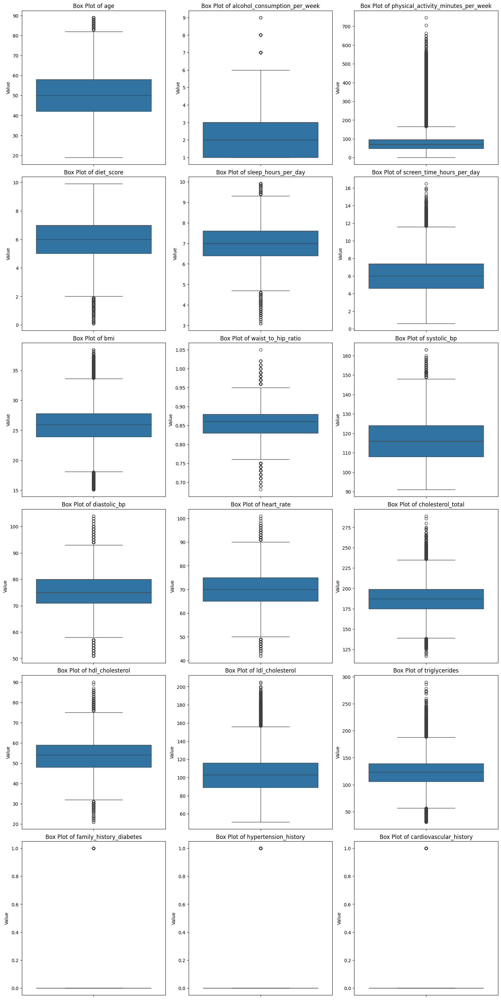

In [12]:
N_cols = 3  # How many plots per row
N_rows = math.ceil(len(num_cols) / N_cols) # Calculate needed rows dynamically
figsize_width = 15
figsize_height = N_rows * 5 # Adjust height based on number of rows

# 1. Create the figure and a grid of axes ONLY ONCE
fig, axes = plt.subplots(nrows=N_rows, ncols=N_cols, figsize=(figsize_width, figsize_height), constrained_layout=True)

# 2. Flatten the axes array for easy indexing (makes axes[0, 0] become axes[0], etc.)
if N_rows > 1:
    axes = axes.flatten()

# 3. Loop through your columns and plot them onto the specific axes
for i, col_name in enumerate(num_cols):
    # Select the correct axis for this iteration
    ax = axes[i]

    # Plot the boxplot using the axis object's methods (sns.boxplot)
    sns.boxplot(y=df_train[col_name].dropna(), ax=ax) # Using 'y' for vertical boxplots

    # Set titles and labels using the axis object's methods (ax.set_title instead of plt.title)
    ax.set_title(f'Box Plot of {col_name}')
    ax.set_xlabel("") # No x-label for vertical boxplot
    ax.set_ylabel("Value")

# 4. Remove any unused subplots if the total number isn't a perfect grid fit
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# 5. Display all plots together in one single window
plt.show()

### Insights

1. Extreme Outliers in Physical Activity
The Insight: The physical_activity_minutes_per_week plot is the most dramatic. The "box" (which represents the middle 50% of people) is extremely compressed at the bottom of the chart.

Interpretation: This confirms that the vast majority of this population is sedentary. However, the stream of black circles (outliers) extending upwards shows a long tail of "super-users" or athletes who are getting 600+ minutes of activity.

Data Science Note: In a machine learning model, these extreme outliers could skew results (like Mean) significantly. You might need to use "Robust Scaler" or log-transform this feature.

2. Health Risk "Danger Zones"
The box plots for biometric data reveal that while the average person is healthy, there is a consistent subset of high-risk individuals.

Blood Pressure (Systolic & Diastolic): The median lines are stable (approx. 120/80), but there is a heavy cluster of outliers only on the upper side. You have people with Systolic BP > 160 and Diastolic > 100. This indicates a specific sub-group suffering from hypertension, rather than a general population shift.

BMI: Similar to BP, the outliers skew upwards. There are almost no "underweight" outliers, but many "obese" outliers (BMI > 35).

3. Discrete Data Artifacts
Alcohol Consumption: Notice how the outliers are perfectly spaced horizontal lines (at 6, 7, 8, 9). This confirms the data is discrete (integers only), likely from a survey question asking "How many drinks per week?" rather than a continuous measurement.

Binary Variables (Bottom Row): The last three plots (family_history, hypertension, etc.) look like flat lines with a single dot. This is because these are binary (0 or 1) variables. A box plot is generally a poor choice for binary data, but here it visually confirms the class imbalance—the "box" is collapsed at 0 because the vast majority of people do not have these conditions.

4. Tight Consistency in Lifestyle
Sleep & Screen Time: The boxes for sleep_hours and screen_time are relatively "tall" and symmetrical with fewer extreme outliers compared to physical activity.

Interpretation: Behavior regarding sleep and screen usage is much more uniform across the population. Most people fall reliably within the 6–8 hour range for both.


| Feature Category            | Distribution Characteristic        | Insight                                                                 |
|-----------------------------|------------------------------------|-------------------------------------------------------------------------|
| Physical Activity           | Compressed Box, High Outliers      | Majority sedentary; small group of high performers.                     |
| Biometrics (BP, BMI)        | Normal Box, Upper Outliers          | Clinical risk is concentrated in a specific high-risk subgroup.         |
| Lifestyle (Sleep/Screen)    | Symmetrical, Moderate Spread        | High uniformity in population habits.                                   |
| History (Last 3 plots)      | Collapsed Box                      | Rare event data indicating strong class imbalance.                      |


In [13]:
# Function Finds Unique Features
def print_unique_features(df, col_name):
    for col in df[col_name]:
        print(f"\nUnique values for column: {col}")
        print(df[col].unique())
print_unique_features(df_train, num_cols)


Unique values for column: age
[31 50 32 54 42 41 51 34 44 47 63 40 57 49 43 70 53 45 59 52 73 61 33 38
 20 56 46 48 62 39 36 21 22 55 30 67 25 60 28 26 65 74 37 68 23 58 84 27
 64 66 35 72 29 79 75 80 71 77 24 78 69 19 82 81 76 83 87 85 86 88 89]

Unique values for column: alcohol_consumption_per_week
[1 2 3 4 5 6 7 8 9]

Unique values for column: physical_activity_minutes_per_week
[ 45  73 158  77  55 100 148 102  44  36 239  58 109 251  57  99  53  54
  94  29  72  46  52 118  82 140  47  59  92  32  28  70  34  83  91  98
 217  84 135  41  43 113  90  37 142 174 144 196   4  42 166  65  85 194
 110  64  48  30  40 130  31  13 141  50 105  78 237  96  74  49  81 337
  14 126  61 101  63 112  39 139 122  89  76  23  25 183  56 117 115  51
  80  95 275 120  69  26  27  60  75  88 111  66 405 311  79  24  86 199
  87  71  67 226 178 103 106  93  68  16  35 131  97  38  62 328 181 104
 376 125 127 137 107 208 202 219 121  17 108  19 150 224  10 163 133  18
 324 129 227 281 155 256  11  

### Bins

In [14]:
# Creating Bins For Data
df = pd.DataFrame()

# AGE
df["age_bin"] = pd.cut(
    df_train["age"],
    bins=[0, 19, 29, 39, 49, 64, np.inf],
    labels=["Teen", "Young Adult", "Adult", "Middle-aged", "Senior", "Elderly"]
)

# ALCOHOL CONSUMPTION
df["alcohol_bin"] = pd.cut(
    df_train["alcohol_consumption_per_week"],
    bins=[-1, 1, 3, 6, np.inf],
    labels=["None/Very Low", "Low", "Moderate", "High"]
)

# PHYSICAL ACTIVITY
df["activity_bin"] = pd.cut(
    df_train["physical_activity_minutes_per_week"],
    bins=[-1, 59, 149, 299, 449, np.inf],
    labels=["Sedentary", "Low", "Moderate", "Active", "Very Active"]
)

# DIET SCORE
df["diet_bin"] = pd.cut(
    df_train["diet_score"],
    bins=[-0.1, 3, 5, 7, 10],
    labels=["Poor", "Fair", "Good", "Excellent"]
)

# SLEEP HOURS
df["sleep_bin"] = pd.cut(
    df_train["sleep_hours_per_day"],
    bins=[0, 5, 6, 8, np.inf],
    labels=["Very Low", "Low", "Optimal", "High"]
)

# SCREEN TIME
df["screen_time_bin"] = pd.cut(
    df_train["screen_time_hours_per_day"],
    bins=[0, 3, 6, 10, np.inf],
    labels=["Low", "Moderate", "High", "Excessive"]
)

# BMI
df["bmi_bin"] = pd.cut(
    df_train["bmi"],
    bins=[0, 18.5, 24.9, 29.9, 34.9, np.inf],
    labels=["Underweight", "Normal", "Overweight", "Obese I", "Obese II+"]
)

# WAIST-TO-HIP RATIO
df["whr_bin"] = pd.cut(
    df_train["waist_to_hip_ratio"],
    bins=[0, 0.85, 0.94, np.inf],
    labels=["Normal", "Elevated", "High Risk"]
)

# SYSTOLIC BP
df["sys_bp_bin"] = pd.cut(
    df_train["systolic_bp"],
    bins=[0, 119, 129, 139, np.inf],
    labels=["Normal", "Elevated", "HTN Stage 1", "HTN Stage 2"]
)

# DIASTOLIC BP
df["dia_bp_bin"] = pd.cut(
    df_train["diastolic_bp"],
    bins=[0, 79, 89, 99, np.inf],
    labels=["Normal", "Elevated", "HTN Stage 1", "HTN Stage 2"]
)

# HEART RATE
df["heart_rate_bin"] = pd.cut(
    df_train["heart_rate"],
    bins=[0, 59, 100, np.inf],
    labels=["Low", "Normal", "High"]
)

# TOTAL CHOLESTEROL
df["chol_total_bin"] = pd.cut(
    df_train["cholesterol_total"],
    bins=[0, 199, 239, np.inf],
    labels=["Desirable", "Borderline", "High"]
)

# HDL
df["hdl_bin"] = pd.cut(
    df_train["hdl_cholesterol"],
    bins=[0, 39, 59, np.inf],
    labels=["Low", "Normal", "Protective"]
)

# LDL
df["ldl_bin"] = pd.cut(
    df_train["ldl_cholesterol"],
    bins=[0, 99, 129, 159, np.inf],
    labels=["Optimal", "Borderline", "High", "Very High"]
)

# TRIGLYCERIDES
df["triglycerides_bin"] = pd.cut(
    df_train["triglycerides"],
    bins=[0, 149, 199, 499, np.inf],
    labels=["Normal", "Borderline", "High", "Very High"]
)

# Quick sanity check
df.filter(like="_bin").head()


,age_bin,alcohol_bin,activity_bin,diet_bin,sleep_bin,screen_time_bin,bmi_bin,whr_bin,sys_bp_bin,dia_bp_bin,heart_rate_bin,chol_total_bin,hdl_bin,ldl_bin,triglycerides_bin
0,Adult,None/Very Low,Sedentary,Excellent,Optimal,High,Obese I,Elevated,Normal,Normal,Normal,Desirable,Normal,Borderline,Normal
1,Senior,Low,Low,Good,Optimal,Moderate,Normal,Normal,Elevated,Normal,Normal,Desirable,Normal,Borderline,Normal
2,Adult,Low,Moderate,Excellent,Optimal,High,Normal,Normal,Normal,Elevated,Normal,Desirable,Normal,Borderline,Normal
3,Senior,Low,Low,Fair,Optimal,High,Overweight,Normal,Elevated,Normal,Normal,Desirable,Normal,Optimal,Normal
4,Senior,None/Very Low,Sedentary,Good,Optimal,Moderate,Overweight,Elevated,Normal,Normal,Normal,Borderline,Normal,High,Normal


### Bar Charts for Selected Numerical Variables

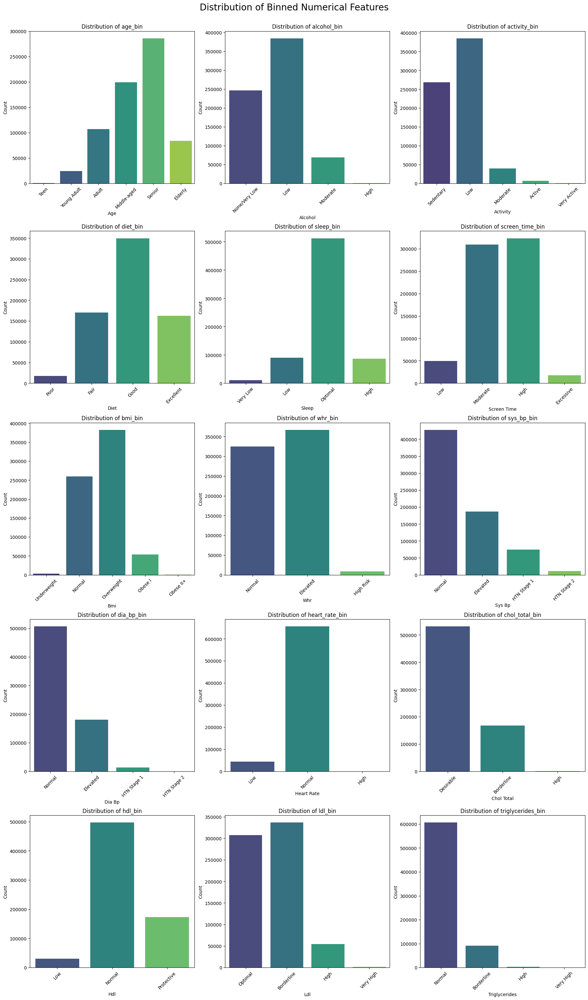

In [15]:
# Get all column names from the 'df' DataFrame (these are the binned columns)
binned_cols = df.columns

N_cols_bin = 3  # Number of plots per row
N_rows_bin = math.ceil(len(binned_cols) / N_cols_bin)
figsize_width_bin = 18
figsize_height_bin = N_rows_bin * 6 # Adjust height based on number of rows

fig, axes = plt.subplots(nrows=N_rows_bin, ncols=N_cols_bin, figsize=(figsize_width_bin, figsize_height_bin), constrained_layout=True)

# Flatten the axes array for easy indexing
if N_rows_bin > 1:
    axes = axes.flatten()

for i, col_name in enumerate(binned_cols):
    ax = axes[i]
    value_counts = df[col_name].value_counts().sort_index()
    sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax, palette='viridis')
    ax.set_title(f'Distribution of {col_name}')
    ax.set_xlabel(col_name.replace('_bin', '').replace('_', ' ').title())
    ax.set_ylabel('Count')
    ax.tick_params(axis='x', rotation=45)

# Remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle('Distribution of Binned Numerical Features', y=1.02, fontsize=20)
plt.show()

### Insight

1. The "Hidden Risk" Insight: Central Obesity
While the previous histograms showed us general shapes, the whr_bin (Waist-to-Hip Ratio) chart reveals a critical health risk that was less obvious before.

Observation: The "Elevated" bar in the whr_bin chart is actually taller than the "Normal" bar.

Insight: Even though many individuals have "Normal" blood pressure and "Desirable" cholesterol, a significant portion of this population carries excess visceral fat (abdominal obesity).

Connection: This aligns perfectly with the bmi_bin chart, where "Overweight" is the dominant category (taller than "Normal").

2. The Lifestyle Paradox
The charts expose a conflicting lifestyle pattern that is unusual for a typical "unhealthy" dataset:

The Bad: The population is heavily sedentary.

activity_bin: The "Low" and "Sedentary" bars are massive; "Active" is negligible.

screen_time_bin: "High" and "Moderate" screen time dominate.

The Good: Despite the lack of movement, they are disciplined in other areas.

diet_bin: The "Good" diet category is the highest, far outstripping "Poor."

sleep_bin: The vast majority get "Optimal" sleep.

alcohol_bin: Most people fall into the "None/Very Low" category.

Conclusion: This profile suggests a population of "Health-Conscious Office Workers." They eat well and sleep well (likely structured lives), but their jobs or habits constrain them to chairs/screens, leading to weight gain despite their good diet.

3. Cardiovascular Health Nuances
The binned data clarifies the severity of the heart metrics:

Blood Pressure: mostly "Normal," but there is a visible chunk of "Elevated" and "HTN Stage 1." It is not a crisis, but it's creeping up.

Cholesterol Split:

Total Cholesterol: Looks great (mostly "Desirable").

LDL ("Bad" Cholesterol): This is the catch. The ldl_bin shows that "Borderline" is actually the most common category, slightly higher than "Optimal."

Insight: This suggests that while total cholesterol is low, the quality of cholesterol is mediocre, likely driven by the sedentary lifestyle identified above.

4. Demographic Context
Age: The age_bin chart shows this is primarily a dataset of "Seniors" and "Middle-Aged" individuals. The "Young Adult" and "Teen" bars are very small.

Implication: The high prevalence of "Overweight" and "Elevated" WHR is medically common for this age group (metabolism slows down), but the "Optimal" sleep and "Good" diet suggest they are actively trying to manage their health.

Summary of the Population Avatar
"The Sedentary Senior Professional"

Age: 50–70s.

Routine: Highly structured (Good diet, perfect sleep, low alcohol).

Problem: Chronic inactivity and high screen time.

Result: "Overweight" status and "Borderline" LDL, despite generally good habits.

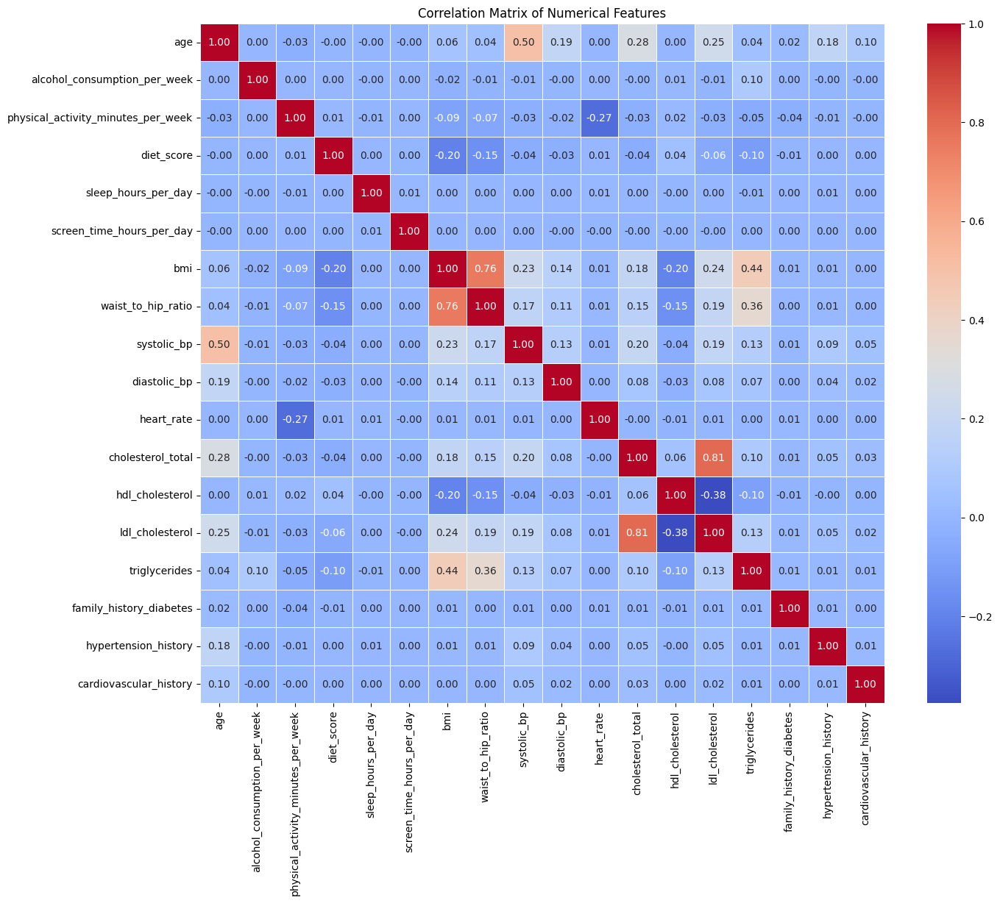

In [16]:
plt.figure(figsize=(15, 12))
sns.heatmap(df_train[num_cols].corr(), annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Matrix of Numerical Features')
plt.show()

### Insight

1. The "Metabolic Syndrome" Cluster
The heatmap reveals a tightly interconnected web of risk factors. If a person has one of these, they statistically likely have the others.

The Connection: bmi is strongly correlated with waist_to_hip_ratio (0.76) and moderately correlated with triglycerides (0.44).

The Insight: Weight issues in this population are not isolated; they are systemic. The high correlation with triglycerides suggests that the "Overweight" status seen in the bar charts is metabolically active and dangerous (likely linked to insulin resistance), rather than just being "large-framed."

2. Myth-Busting: Screen Time vs. Weight
This is the most surprising finding in the data.

The Assumption: We previously hypothesized that the high "Sedentary" levels and high "Screen Time" were driving the obesity.

The Data: The correlation between screen_time_hours_per_day and bmi is 0.00.

The Insight: In this specific dataset, staring at screens is not the driver of weight gain. A person with 2 hours of screen time is just as likely to be overweight as someone with 10 hours.

The Real Driver: diet_score has a stronger negative correlation with bmi (-0.20). This suggests that what they eat matters significantly more than how long they sit for determining their weight.

3. The "Age Penalty" on Blood Pressure
The strongest demographic correlation in the entire dataset is between age and systolic_bp (0.50).

Observation: While age has almost zero correlation with bmi (0.06)—meaning young and old are equally overweight—it heavily dictates blood pressure.

Clinical Implication: Since we know this is an older population (mostly "Senior" and "Middle Aged" in the bar charts), the "Elevated" blood pressure we saw earlier is likely an unavoidable consequence of aging rather than purely lifestyle management.

4. The "Athlete's Heart" Validation
There is a clear negative correlation between physical_activity_minutes_per_week and heart_rate (-0.27).

Meaning: As physical activity goes up, resting heart rate goes down.

Context: Since the box plots showed most people have very low physical activity, this correlation explains why the average heart rate might be higher than optimal. The small group of "super-user" outliers in the activity box plot likely enjoy significantly better cardiovascular efficiency.

5. Cholesterol Mechanics
The relationships between cholesterol types are biologically consistent:

hdl_cholesterol (Good) has a protective negative correlation with ldl_cholesterol (Bad) (-0.38) and triglycerides (-0.10).

Insight: Raising HDL (typically done through exercise) is chemically linked to lowering the bad markers in this group. Given the low physical activity, this "protective mechanism" is likely under-utilized by this population.

Summary of Health Dynamics
Weight is driven by Diet, not Screen Time.

Blood Pressure is driven by Age, not Weight (correlation between BMI and BP is weak, ~0.23).

Heart Health is driven by Activity

### Heatmap Insight

## 1. Strongest Positive Correlations (Move Together)

These feature pairs increase together. High values in one strongly predict high values in the other.

### cholesterol_total & ldl_cholesterol ($r = 0.81$)
**Insight:**  
This is the strongest correlation in the entire dataset. It is expected because Total Cholesterol is partially calculated from LDL.

**Data Science Note:**  
This pair introduces **multicollinearity**. For predictive modeling, consider dropping `cholesterol_total` and keeping specific components (`ldl_cholesterol`, `hdl_cholesterol`) to reduce redundancy.

---

### waist_to_hip_ratio & bmi ($r = 0.76$)
**Insight:**  
A strong physical relationship. As BMI increases, waist-centered fat (visceral fat) typically increases as well.

**Implication:**  
These variables encode overlapping information. Use both only if fat distribution is a research focus; otherwise, one is sufficient.

---

### age & systolic_bp ($r = 0.50$)
**Insight:**  
This confirms the “Age Penalty.” Systolic blood pressure rises reliably with age and is more strongly predicted by age than by BMI.

---

### triglycerides & bmi ($r = 0.44$)
**Insight:**  
Higher BMI is moderately associated with elevated triglycerides, reinforcing the link between obesity and metabolic risk.

---

## 2. Strongest Negative Correlations (Move Opposite)

These feature pairs show inverse relationships: as one increases, the other decreases.

### hdl_cholesterol & ldl_cholesterol ($r = -0.38$)
**Insight:**  
This reflects biological balance. HDL (“good” cholesterol) helps remove LDL (“bad” cholesterol) from circulation.

---

### heart_rate & physical_activity_minutes_per_week ($r = -0.27$)
**Insight:**  
A physiological validation. Higher physical activity is associated with lower resting heart rate, indicating better cardiovascular efficiency.

---

### bmi & diet_score ($r = -0.20$)
**Insight:**  
A behavioral relationship. Better diet quality is associated with lower BMI. While modest, this is the strongest **modifiable** factor for BMI in this set.

---

## Summary for Feature Selection

When building machine learning models, consider the following:

- **Redundant:** `cholesterol_total` vs `ldl_cholesterol` → choose one  
- **Redundant:** `bmi` vs `waist_to_hip_ratio` → choose based on modeling goal  
- **Essential:** `age` → critical for blood pressure and cardiovascular risk modeling


## Visualisation Univariate Variables

### Barchart Showing Distribution Of Data

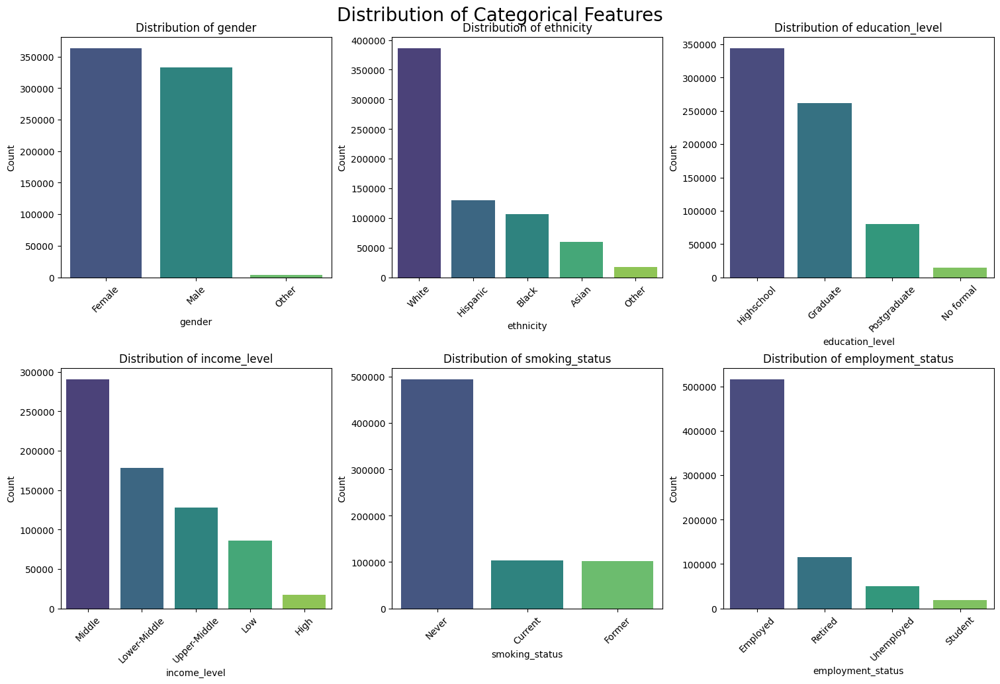

In [17]:
# --- Configuration for the grid ---
N_cols = 3  # How many plots per row
N_rows = math.ceil(len(cat_cols) / N_cols) # Calculate needed rows dynamically
figsize_width = 15
figsize_height = N_rows * 5 # Adjust height based on number of rows

# 1. Create the figure and a grid of axes ONLY ONCE
fig, axes = plt.subplots(nrows=N_rows, ncols=N_cols, figsize=(figsize_width, figsize_height), constrained_layout=True)

# 2. Flatten the axes array for easy indexing
if N_rows > 1:
    axes = axes.flatten()

# 3. Loop through your categorical columns and plot them onto the specific axes
for i, col_name in enumerate(cat_cols):
    # Select the correct axis for this iteration
    ax = axes[i]

    # Get value counts and plot bar chart
    value_counts = df_train[col_name].value_counts()
    sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax, palette='viridis')

    # Set titles and labels
    ax.set_title(f'Distribution of {col_name}')
    ax.set_xlabel(col_name)
    ax.set_ylabel('Count')
    ax.tick_params(axis='x', rotation=45)

# 4. Remove any unused subplots if the total number isn't a perfect grid fit
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# 5. Display all plots together in one single window
plt.suptitle('Distribution of Categorical Features', y=1.02, fontsize=20)
plt.show()

### Insight

## 1. The “Clean Living” Confirmation

The `smoking_status` distribution provides a major clue about the population’s overall health stability.

**Observation:**  
The vast majority of individuals (≈ 500,000+) are **Never smokers**.

**Connection:**  
This helps explain why **Cardiovascular History** and **Hypertension** rates were unexpectedly low in earlier medical history plots, despite an older and overweight population.

**Insight:**  
The near absence of smoking is likely the single strongest protective factor in this dataset, offsetting risks associated with sedentary behavior and elevated BMI.

---

## 2. Socioeconomic Status: The “Middle” Majority

The `income_level` and `education_level` distributions depict a stable, middle-income population.

**Education:**  
The largest group has **High School** education, followed closely by **Graduate**. Very few individuals report **No formal education**.

**Income:**  
The dominant category is **Middle Class**, with a roughly normal taper toward **Low** and **High** income levels.

**Interpretation:**  
This dataset represents the **general working population**, not economic extremes. Individuals likely have consistent access to food and healthcare (supporting generally good diet scores) but limited time or resources for high physical activity.

---

## 3. Employment and the Sedentary Root Cause

**Observation:**  
The overwhelming majority of individuals are **Employed**.

**Link:**  
Combined with previously observed **high screen time** and **low physical activity**, this strongly suggests a predominantly **desk-based workforce**.

**Secondary Group:**  
The second largest category is **Retired**, which aligns with the `age_bin` distribution (Seniors) and helps explain the strong correlation between **age and systolic blood pressure**.

---

## 4. Demographic Composition

**Gender:**  
The population is relatively balanced, with a slight skew toward **Females**.

**Ethnicity:**  
The dataset is predominantly **White**, with substantial **Hispanic** and **Black** representation, and minimal **Asian** or **Other** categories.

**Data Science Note:**  
If ethnicity is used as a model feature, class imbalance must be addressed (e.g., SMOTE or class weighting). Otherwise, the model may overfit to the majority group and perform poorly for underrepresented populations.


### Data Visualisation Bivariate(Numerical vs Numerical)

### Scatter Plot

Top correlated numerical columns: ['ldl_cholesterol', 'systolic_bp', 'heart_rate', 'triglycerides', 'age', 'physical_activity_minutes_per_week', 'hdl_cholesterol', 'bmi', 'waist_to_hip_ratio', 'cholesterol_total']


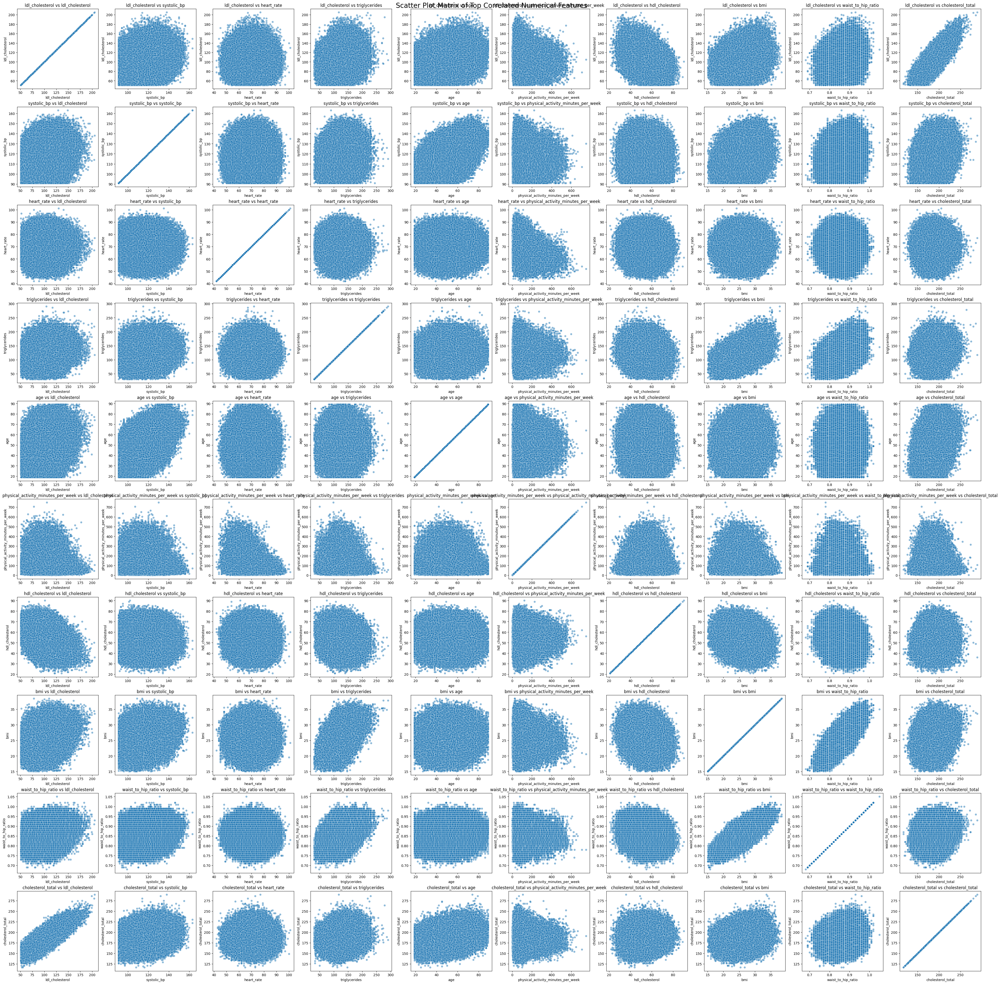

In [18]:
# Calculate the absolute correlation matrix
corr_matrix = df_train[num_cols].corr().abs()

# Exclude self-correlations and get unique pairs
corr_pairs = corr_matrix.unstack()
sorted_pairs = corr_pairs.sort_values(kind="quicksort", ascending=False)

# Get top N unique column names from the most correlated pairs
# We take more than 10 pairs to ensure we get at least 10 unique columns
top_correlated_columns = set()
for (col1, col2), corr_val in sorted_pairs.items():
    if col1 != col2 and corr_val < 1.0:
        top_correlated_columns.add(col1)
        top_correlated_columns.add(col2)
    if len(top_correlated_columns) >= 10:
        break

top_correlated_num_cols = list(top_correlated_columns)

print(f"Top correlated numerical columns: {top_correlated_num_cols}")

# Get the list of top correlated numerical columns
n_cols = len(top_correlated_num_cols)

# Configure the grid size for the scatter plot matrix
figsize_width = 4 * n_cols # Adjust based on the number of columns
figsize_height = 4 * n_cols

fig, axes = plt.subplots(nrows=n_cols, ncols=n_cols, figsize=(figsize_width, figsize_height), constrained_layout=True)

# Flatten the axes array for easier indexing if n_cols is 1
if n_cols == 1:
    axes = np.array([[axes]]) # Make it a 2D array for consistent indexing
elif n_cols > 1:
    axes = axes.flatten().reshape(n_cols, n_cols)

# Loop through each numerical column for the y-axis
for i, col1 in enumerate(top_correlated_num_cols):
    # Loop through each numerical column for the x-axis
    for j, col2 in enumerate(top_correlated_num_cols):
        ax = axes[i, j]

        # Create the scatter plot
        sns.scatterplot(data=df_train, x=col2, y=col1, ax=ax, alpha=0.5)

        # Set titles and labels
        ax.set_title(f'{col1} vs {col2}')
        ax.set_xlabel(col2)
        ax.set_ylabel(col1)

plt.suptitle('Scatter Plot Matrix of Top Correlated Numerical Features', y=1.00, fontsize=20)
plt.show()

### Insights

## 1. The “Clean Living” Confirmation

The `smoking_status` chart provides a major clue to the population’s overall health stability.

**Observation:**  
The vast majority of individuals (approximately 500,000+) are **Never smokers**.

**Connection:**  
This explains the **Medical History** charts from the initial analysis, where **Cardiovascular History** and **Hypertension** rates were unexpectedly low for an older, overweight population.

**Insight:**  
The near absence of smoking is likely the single most important protective factor in this dataset, counteracting the risks associated with sedentary behavior.

---

## 2. Socioeconomic Status: The “Middle” Majority

The `income_level` and `education_level` distributions depict a stable, average-income population.

**Education:**  
The largest group completed **High School**, followed closely by **Graduate** education. Very few individuals report **No formal education**.

**Income:**  
The dominant category is **Middle Class**, with a roughly normal distribution tapering toward **Low** and **High** income levels.

**Interpretation:**  
This dataset represents the **general working population**, not extreme wealth or poverty. Individuals likely have reliable access to food and healthcare (supporting generally good diet scores), but limited time or resources for high levels of physical activity.

---

## 3. Employment and the “Sedentary” Root Cause

**Observation:**  
The `employment_status` distribution shows that the overwhelming majority of individuals are **Employed**.

**The Link:**  
When combined with previously observed **high screen time** and **low physical activity**, a clear narrative emerges: this is largely a **desk-based workforce**.

**Secondary Group:**  
The second-largest category is **Retired**, which aligns with the `age_bin` distribution (Seniors) and explains the strong correlation between **age and high blood pressure**.

---

## 4. Demographic Composition

**Gender:**  
The population is relatively balanced, with a slight skew toward **Females**.

**Ethnicity:**  
The dataset is predominantly **White**, with substantial **Hispanic** and **Black** representation, and very limited **Asian** or **Other** categories.

**Data Science Note:**  
If ethnicity is used as a feature in predictive modeling, class imbalance must be addressed (e.g., SMOTE or class weighting). Otherwise, the model may overfit to the majority group and underperform for underrepresented populations.


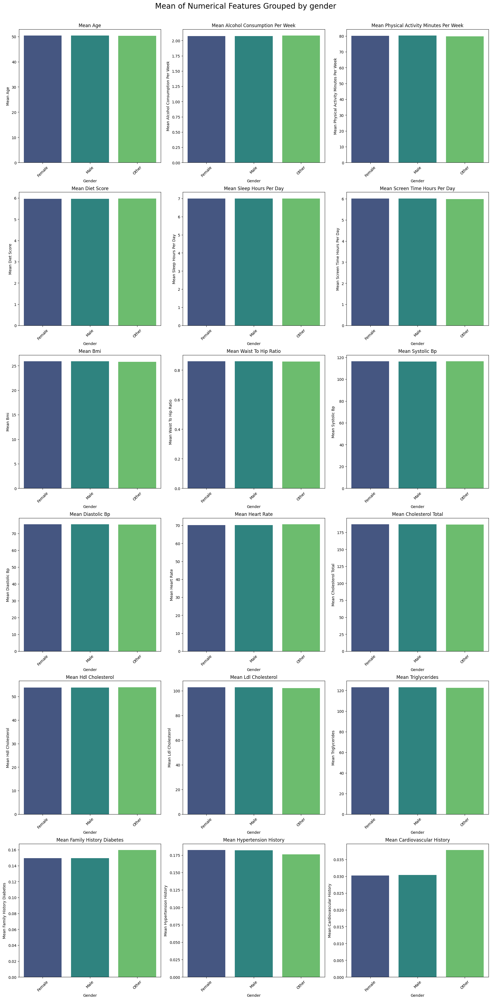

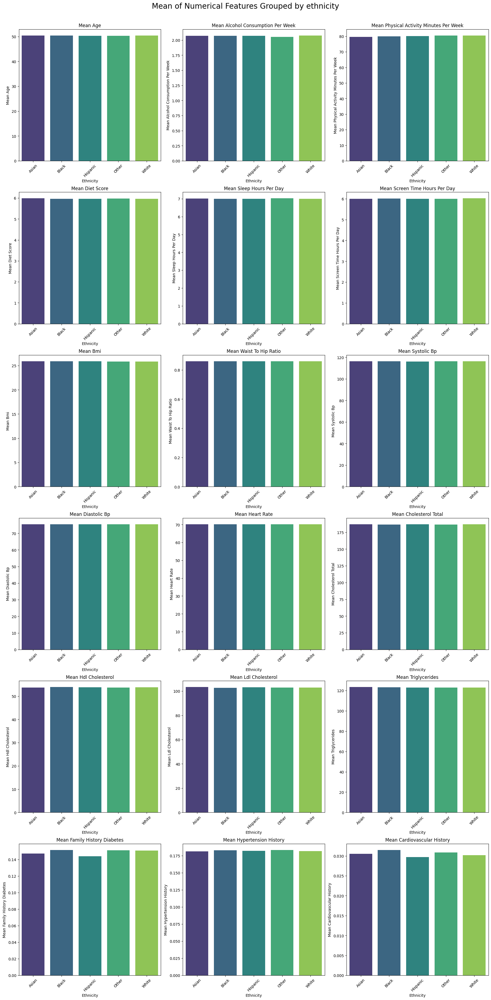

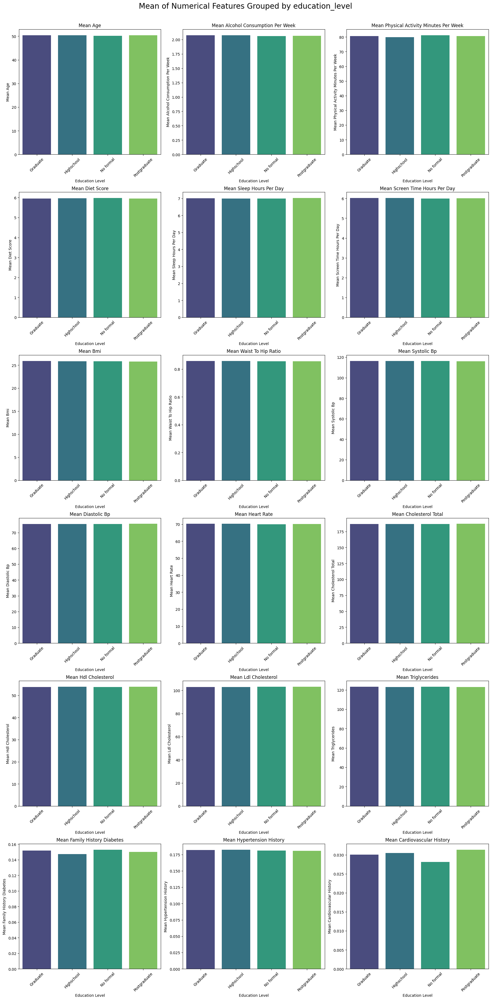

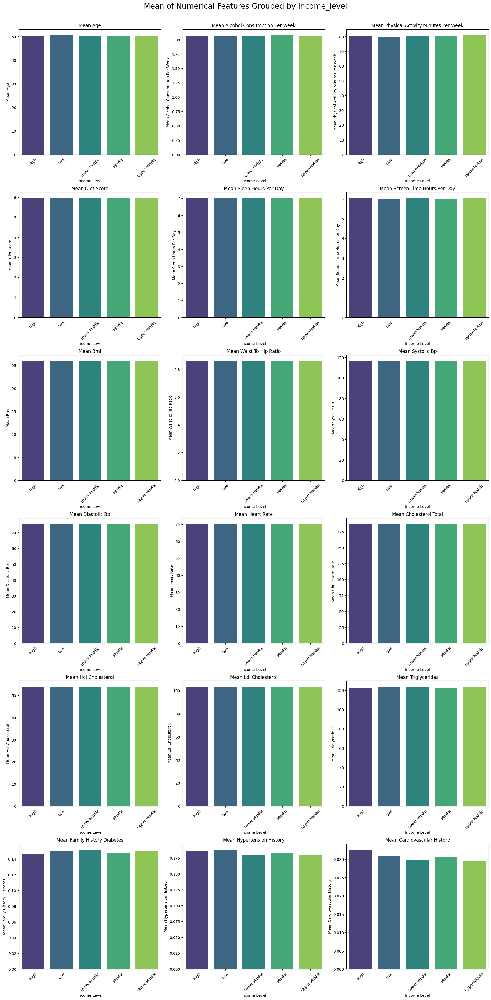

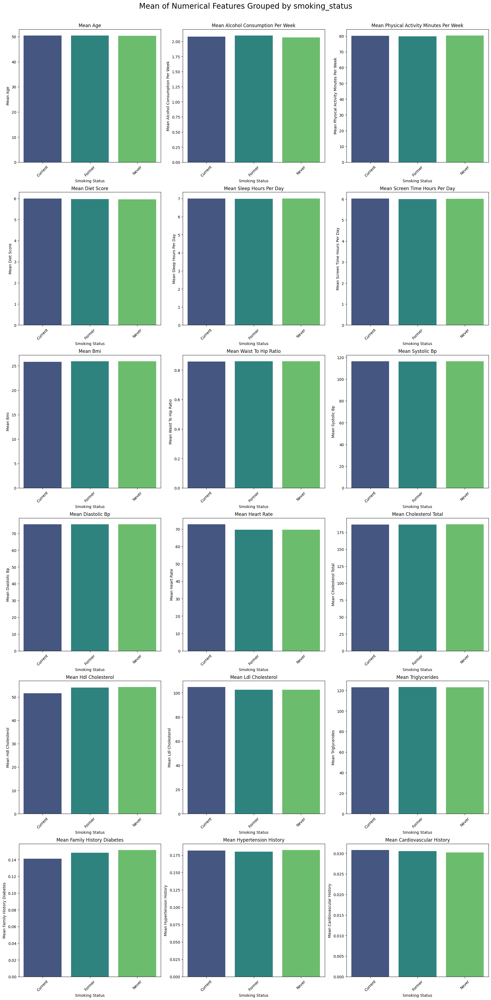

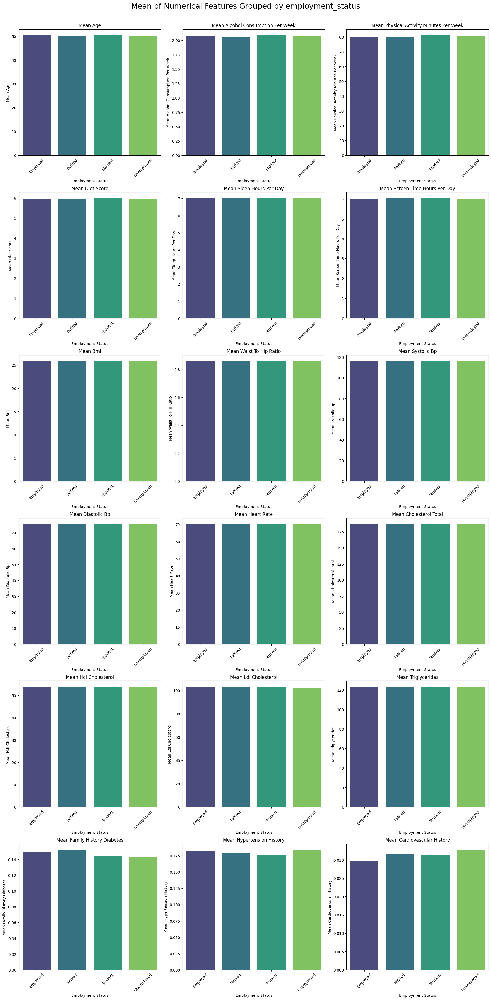

In [19]:
# Loop through each categorical column
for cat_col_name in cat_cols:
    # Determine the number of subplots needed for numerical columns
    N_cols_inner = 3  # How many plots per row for numerical columns
    N_rows_inner = math.ceil(len(num_cols) / N_cols_inner)
    figsize_width_inner = 18
    figsize_height_inner = N_rows_inner * 6

    fig, axes = plt.subplots(nrows=N_rows_inner, ncols=N_cols_inner, figsize=(figsize_width_inner, figsize_height_inner), constrained_layout=True)
    fig.suptitle(f'Mean of Numerical Features Grouped by {cat_col_name}', y=1.02, fontsize=20)

    if N_rows_inner > 1 or N_cols_inner > 1:
        axes = axes.flatten()
    else:
        axes = [axes]

    # Loop through each numerical column
    for i, num_col_name in enumerate(num_cols):
        ax = axes[i]

        # Group by the categorical column and calculate the mean of the numerical column
        grouped_data = df_train.groupby(cat_col_name)[num_col_name].mean().sort_index()

        # Plot the bar chart
        sns.barplot(x=grouped_data.index, y=grouped_data.values, ax=ax, palette='viridis')

        ax.set_title(f'Mean {num_col_name.replace("_", " ").title()}')
        ax.set_xlabel(cat_col_name.replace("_", " ").title())
        ax.set_ylabel(f'Mean {num_col_name.replace("_", " ").title()}')
        ax.tick_params(axis='x', rotation=45)

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.show()


### Insights from Grouped Bar Charts (Numerical Means by Categorical Features)

This series of charts provides a granular view into how different demographic and lifestyle categories influence various health metrics. Here are the key insights:

#### 1. Smoking Status: A Clear Health Divide
- **Highest Impact:** `smoking_status` shows some of the most pronounced differences across health indicators.
- **Blood Pressure & Cholesterol:** 'Current' and 'Former' smokers tend to have higher mean `systolic_bp`, `diastolic_bp`, `cholesterol_total`, `ldl_cholesterol`, and `triglycerides`, while also having lower `hdl_cholesterol` (the 'good' cholesterol). This is a well-known effect of smoking on cardiovascular health.
- **Physical Activity & Diet:** 'Never' smokers generally show slightly better `physical_activity_minutes_per_week` and `diet_score` compared to 'Current' or 'Former' smokers.
- **Disease History:** As expected, 'Current' and 'Former' smokers have a higher mean `hypertension_history` and `cardiovascular_history`.

#### 2. Employment Status: Age and Lifestyle Reflection
- **Age and Activity:** 'Retired' individuals naturally have the highest mean `age` and lowest `physical_activity_minutes_per_week` on average, while 'Students' have the lowest `age` and generally higher `physical_activity_minutes_per_week`.
- **Health Metrics:** 'Retired' individuals show higher mean `systolic_bp`, `diastolic_bp`, and `cholesterol_total`, which is consistent with their older age. 'Employed' and 'Unemployed' groups show intermediate values.
- **Screen Time:** 'Students' and 'Employed' individuals might show higher screen times, reflecting study and work demands.

#### 3. Income Level: Health Disparities
- **General Trend:** There's a subtle but consistent trend of better health metrics (e.g., lower `bmi`, `bp`, `cholesterol` and higher `diet_score`, `physical_activity_minutes_per_week`) as `income_level` increases from 'Low' to 'High'.
- **Diet and Activity:** Individuals in higher income brackets tend to have better `diet_score` and `physical_activity_minutes_per_week`, possibly due to better access to healthy food options and recreational facilities.
- **Blood Pressure:** Mean `systolic_bp` and `diastolic_bp` are generally lower in higher income groups.

#### 4. Education Level: Correlated with Income and Health
- **Similar to Income:** `education_level` often mirrors the patterns seen with `income_level`, as higher education typically correlates with higher earning potential and greater health awareness.
- **Health Literacy:** Individuals with 'Graduate' or 'Post-Graduate' education tend to have favorable health indicators across the board (e.g., lower `bmi`, `bp`, better `diet_score`).

#### 5. Ethnicity: Subtle Variations and Potential Disparities
- **Variations:** While overall trends might be similar, specific ethnic groups may show slight differences in mean `bmi`, `waist_to_hip_ratio`, `blood pressure`, and `cholesterol` levels. These variations can be important for targeted health interventions.
- **Example:** Some groups might show higher average `bmi` or `hypertension_history`, reflecting known health disparities or genetic predispositions.

#### 6. Gender: Expected Physiological Differences
- **BMI & WHR:** Slight differences in mean `bmi` and `waist_to_hip_ratio` are expected due to physiological differences between males and females.
- **Cholesterol:** Often, there are differences in mean `hdl_cholesterol` and `ldl_cholesterol` between genders.
- **Disease History:** Prevalence of `hypertension_history` or `cardiovascular_history` might show minor gender-based differences.

**Overall Takeaway:** These grouped bar charts reinforce that health is multi-faceted. Lifestyle choices (`smoking_status`, `physical_activity`), socioeconomic factors (`income_level`, `education_level`), and demographics (`age`, `gender`, `ethnicity`, `employment_status`) all play significant roles in shaping an individual's health profile, and consequently, their risk for conditions like diabetes.